# Analisis del Hashtag #messi

El programa trabaja con los datos descargados en un .csv y analiza los twitts de la ultima semana

# Leer Datos

In [1]:
import re, string
import pandas as pd

file = open("tweets_full - copia.csv", "r", encoding="utf-8", errors="ignore")
lines = file.readlines()
file.close()

new_lines = []
for line in lines:
    if "Python" not in line or "NFT" not in line:
        new_lines.append(line)

#new_lines = list(set(new_lines))
        
file = open("tweets_full.csv", "w", encoding="utf-8", errors="ignore")
file.writelines(new_lines)
file.close()


pd.set_option('display.max_colwidth', None)
df = pd.read_csv("tweets_full.csv", error_bad_lines=False)
df = df[['text']]
df = df.drop_duplicates()
df

b'Skipping line 470: expected 4 fields, saw 5\nSkipping line 735: expected 4 fields, saw 5\nSkipping line 827: expected 4 fields, saw 5\nSkipping line 987: expected 4 fields, saw 5\nSkipping line 1015: expected 4 fields, saw 5\nSkipping line 1306: expected 4 fields, saw 6\nSkipping line 1411: expected 4 fields, saw 5\nSkipping line 1430: expected 4 fields, saw 5\nSkipping line 1449: expected 4 fields, saw 5\nSkipping line 1789: expected 4 fields, saw 5\nSkipping line 4374: expected 4 fields, saw 5\nSkipping line 4470: expected 4 fields, saw 6\nSkipping line 4477: expected 4 fields, saw 5\nSkipping line 4726: expected 4 fields, saw 5\nSkipping line 4983: expected 4 fields, saw 5\nSkipping line 5012: expected 4 fields, saw 5\n'


,text
0,Nnamdi Kanu challenges competence of FG’s fresh terrorism charges - https://t.co/tDXmsvhRrI #News #NnamdiKanu#BBnaija #Messi #Wizkid #Davido
1,💙❤️Our future\r\n\r\n#فاتي #AnsuFati2027 #AnsuFati \r\n#برشلونة #FCBarcelona #ميسي #Messi https://t.co/OO5dlCa8ur
2,The race gets tougher with every passing event!\r\n\r\n🤷🏾‍♂️Who wins the ballon d'or❓\r\n\r\n👉Ronaldo \r\n👉Messi\r\n👉Lukaku \r\n👉Mo Salah \r\n👉Halaand\r\n👉 Lewandowski \r\nhttps://t.co/k11AzLRVMA\r\n\r\nMbappe Messi Penalty #Messi Lionel Messi Hat-trick #Ronaldo #ChampionsLeague https://t.co/AWMxBgltEe
3,"Ebonyi residents observe sit-at-home, banks remove Nigerian flags - Nnamdi Kanu’s trial - https://t.co/Mstz2nSXiE #News #Ebonyi #NnamdiKanu’strial#BBnaija #Messi #Wizkid #Davido"
4,No Credit for Bruno ?!#UCL #Ronaldo #MUFC #Messi @sv120705 @BarcaFanPageENG @RedDevilsDaily @barcagirl24 @BarcaStat @ManUnitedFanBox @Ronaldofan56 @ronaldohater @Messifanboy1019 @HaterMessi @LiveTVIsAwesome @brunofamigo @RedDevilsHub @MCityfan15 @ManUnitedHater @krooshav 🔴👹 https://t.co/rc9xh2D2JB
...,...
6454,@goal No one:\r\n\r\nAbsolutely No one:\r\n\r\nThe WHOLE WORLD trying to STOP Messi from winning the 7th #BallonDor \r\n#LM7 #Messi # BallonDor2021 https://t.co/9JK9W7yVkH
6455,Without telling us you're from eFootball\r\n\r\n#efootball #fifa #fifa22 #messi #ronaldo #cristianoronaldo #sportsfans #footballchat #footballnews #footballjokes #footballmemes #footballbanter https://t.co/BpJp1Kfh8I
6456,No..Its Not... \r\n\r\nThe Ballon d’Or is only for the Goat 🐐 (Lionel Messi)...Don't you know that ? \r\n\r\n#Messi #BallonDor https://t.co/bcTIZRS4Du
6457,"@Ali_Pele123 Crazy to think, #Pelé never played at Wembley with Brazil. I don't think either #Messi &amp; #Ronaldo have played at Wembley with Argentina &amp; Portugal. Surely, that is something the F. A. of each country has to fix, before these two lad's retire."


# Limpieza

In [2]:
URL_REGEX = r"(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:'\".,<>?«»“”‘’]))"
MENTIONS_REGEX = r"(?<=^|(?<=[^a-zA-Z0-9-_\.]))@([A-Za-z]+[A-Za-z0-9-_]+)"
HASHTAG_REGEX = r"#"

df["text"].replace(URL_REGEX,'',regex=True, inplace = True)
df["text"].replace(MENTIONS_REGEX,'',regex=True, inplace = True)
df["text"].replace(HASHTAG_REGEX,'',regex=True, inplace = True)
df["text"].replace(r"[^A-Za-z0-9 | \n]+",' ',regex=True, inplace = True)
df["text"].replace(r"\t",' ',regex=True, inplace = True)
df["text"].replace('[{}]'.format(string.punctuation),' ',regex=True, inplace = True)
df["text"].replace('[^a-zA-Z]',' ',regex=True, inplace = True)
df['text'].dropna(inplace=True)

df["text"] = df["text"].str.lower()

df

,text
0,nnamdi kanu challenges competence of fg s fresh terrorism charges news nnamdikanubbnaija messi wizkid davido
1,our future ansufati ansufati fcbarcelona messi
2,the race gets tougher with every passing event who wins the ballon d or ronaldo messi lukaku mo salah halaand lewandowski mbappe messi penalty messi lionel messi hat trick ronaldo championsleague
3,ebonyi residents observe sit at home banks remove nigerian flags nnamdi kanu s trial news ebonyi nnamdikanu strialbbnaija messi wizkid davido
4,no credit for bruno ucl ronaldo mufc messi
...,...
6454,no one absolutely no one the whole world trying to stop messi from winning the th ballondor lm messi ballondor
6455,without telling us you re from efootball efootball fifa fifa messi ronaldo cristianoronaldo sportsfans footballchat footballnews footballjokes footballmemes footballbanter
6456,no its not the ballon d or is only for the goat lionel messi don t you know that messi ballondor
6457,crazy to think pel never played at wembley with brazil i don t think either messi amp ronaldo have played at wembley with argentina amp portugal surely that is something the f a of each country has to fix before these two lad s retire


# Tokenizar

In [3]:
from nltk.tokenize import TweetTokenizer

tt = TweetTokenizer()

tokenized_text = df['text'].fillna("").apply(tt.tokenize)
df["tokenized_text"] = tokenized_text
df

,text,tokenized_text
0,nnamdi kanu challenges competence of fg s fresh terrorism charges news nnamdikanubbnaija messi wizkid davido,"[nnamdi, kanu, challenges, competence, of, fg, s, fresh, terrorism, charges, news, nnamdikanubbnaija, messi, wizkid, davido]"
1,our future ansufati ansufati fcbarcelona messi,"[our, future, ansufati, ansufati, fcbarcelona, messi]"
2,the race gets tougher with every passing event who wins the ballon d or ronaldo messi lukaku mo salah halaand lewandowski mbappe messi penalty messi lionel messi hat trick ronaldo championsleague,"[the, race, gets, tougher, with, every, passing, event, who, wins, the, ballon, d, or, ronaldo, messi, lukaku, mo, salah, halaand, lewandowski, mbappe, messi, penalty, messi, lionel, messi, hat, trick, ronaldo, championsleague]"
3,ebonyi residents observe sit at home banks remove nigerian flags nnamdi kanu s trial news ebonyi nnamdikanu strialbbnaija messi wizkid davido,"[ebonyi, residents, observe, sit, at, home, banks, remove, nigerian, flags, nnamdi, kanu, s, trial, news, ebonyi, nnamdikanu, strialbbnaija, messi, wizkid, davido]"
4,no credit for bruno ucl ronaldo mufc messi,"[no, credit, for, bruno, ucl, ronaldo, mufc, messi]"
...,...,...
6454,no one absolutely no one the whole world trying to stop messi from winning the th ballondor lm messi ballondor,"[no, one, absolutely, no, one, the, whole, world, trying, to, stop, messi, from, winning, the, th, ballondor, lm, messi, ballondor]"
6455,without telling us you re from efootball efootball fifa fifa messi ronaldo cristianoronaldo sportsfans footballchat footballnews footballjokes footballmemes footballbanter,"[without, telling, us, you, re, from, efootball, efootball, fifa, fifa, messi, ronaldo, cristianoronaldo, sportsfans, footballchat, footballnews, footballjokes, footballmemes, footballbanter]"
6456,no its not the ballon d or is only for the goat lionel messi don t you know that messi ballondor,"[no, its, not, the, ballon, d, or, is, only, for, the, goat, lionel, messi, don, t, you, know, that, messi, ballondor]"
6457,crazy to think pel never played at wembley with brazil i don t think either messi amp ronaldo have played at wembley with argentina amp portugal surely that is something the f a of each country has to fix before these two lad s retire,"[crazy, to, think, pel, never, played, at, wembley, with, brazil, i, don, t, think, either, messi, amp, ronaldo, have, played, at, wembley, with, argentina, amp, portugal, surely, that, is, something, the, f, a, of, each, country, has, to, fix, before, these, two, lad, s, retire]"


# Frecuencia de los datos

In [4]:
from nltk.probability import FreqDist

tokenized_list = df.explode('tokenized_text')

fdist = FreqDist(tokenized_list['tokenized_text'])

df_fdist = pd.DataFrame.from_dict(fdist, orient='index')
df_fdist.columns = ['Frequency']
df_fdist.index.name = 'Term'
df_fdist.sort_values(by=['Frequency'], inplace=True, ascending=False)
pd.set_option('display.max_rows', None)
df_fdist

,Frequency
Term,
messi,7016
the,3068
to,1677
and,1493
psg,1447
is,1413
a,1352
t,1292
in,1287


# Nube de palabras de los datos en bruto

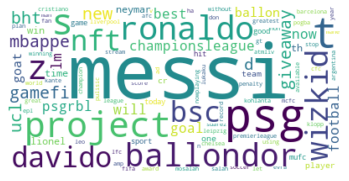

In [5]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

wordcloud = WordCloud(max_words=100, background_color="white", collocations = False).generate(df['tokenized_text'].to_string())

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.rcParams['figure.figsize'] = [150, 150]
plt.show()

# Stop Words

In [6]:
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))
no_stopwords_data = []

for x in tokenized_text:
    for word in x:
        if word.lower() not in stop_words:
            no_stopwords_data.append(word)

"""
stop_words = set(stopwords.words('spanish'))
no_stopwords_data2 = []
            
for word in no_stopwords_data:
    if word.lower() not in stop_words:
        no_stopwords_data2.append(word)
"""
#no_stopwords_data = no_stopwords_data2
"""for word in no_stopwords_data[:]:
    word.remove('nft')
no_stopwords_data.remove('nft')
no_stopwords_data"""
df

,text,tokenized_text
0,nnamdi kanu challenges competence of fg s fresh terrorism charges news nnamdikanubbnaija messi wizkid davido,"[nnamdi, kanu, challenges, competence, of, fg, s, fresh, terrorism, charges, news, nnamdikanubbnaija, messi, wizkid, davido]"
1,our future ansufati ansufati fcbarcelona messi,"[our, future, ansufati, ansufati, fcbarcelona, messi]"
2,the race gets tougher with every passing event who wins the ballon d or ronaldo messi lukaku mo salah halaand lewandowski mbappe messi penalty messi lionel messi hat trick ronaldo championsleague,"[the, race, gets, tougher, with, every, passing, event, who, wins, the, ballon, d, or, ronaldo, messi, lukaku, mo, salah, halaand, lewandowski, mbappe, messi, penalty, messi, lionel, messi, hat, trick, ronaldo, championsleague]"
3,ebonyi residents observe sit at home banks remove nigerian flags nnamdi kanu s trial news ebonyi nnamdikanu strialbbnaija messi wizkid davido,"[ebonyi, residents, observe, sit, at, home, banks, remove, nigerian, flags, nnamdi, kanu, s, trial, news, ebonyi, nnamdikanu, strialbbnaija, messi, wizkid, davido]"
4,no credit for bruno ucl ronaldo mufc messi,"[no, credit, for, bruno, ucl, ronaldo, mufc, messi]"
5,are messi and ronaldo still the two best players in the world messi ronaldo ucl,"[are, messi, and, ronaldo, still, the, two, best, players, in, the, world, messi, ronaldo, ucl]"
6,the himself lm messi,"[the, himself, lm, messi]"
7,what if messi wins championsleague with goes back to and win them the championsleague and retires,"[what, if, messi, wins, championsleague, with, goes, back, to, and, win, them, the, championsleague, and, retires]"
8,waiting on a long line at the store amp two guys in front of me were arguing for min about who s better messi or ronaldo they were heated i love soccerfans but the answer is actually simple they kept me entertained tho,"[waiting, on, a, long, line, at, the, store, amp, two, guys, in, front, of, me, were, arguing, for, min, about, who, s, better, messi, or, ronaldo, they, were, heated, i, love, soccerfans, but, the, answer, is, actually, simple, they, kept, me, entertained, tho]"
9,football most shocked goals in last seconds via ronaldo messi manchesterunited goals football epic championsleague worldcup best,"[football, most, shocked, goals, in, last, seconds, via, ronaldo, messi, manchesterunited, goals, football, epic, championsleague, worldcup, best]"


# Nube de palabras sin stop words

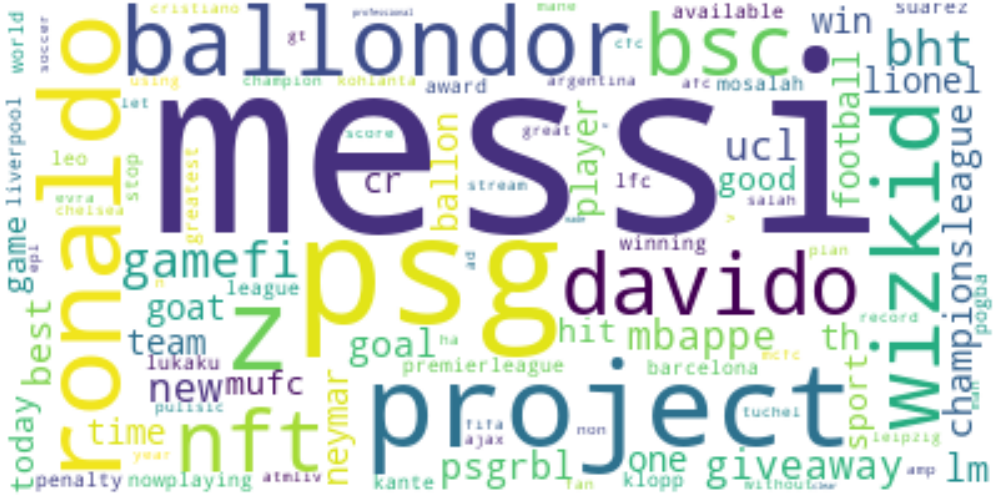

In [7]:
data = " ".join(map(str, no_stopwords_data))
wordcloud = WordCloud(max_words=100, background_color="white", collocations = False).generate(data)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.rcParams['figure.figsize'] = [150, 150]
plt.show()

# Etiquetado POS

In [8]:
import re
import nltk
data_pos = nltk.pos_tag(no_stopwords_data)
p_adj = re.compile(r"(^JJ)")
p_noun = re.compile(r"(^NN)")
p_verb = re.compile(r"(^VB)")
p_adverb = re.compile(r"(^RB)")

adjectives, nouns, verbs, adverbs = [], [], [], []
for k,v in data_pos:
    if re.fullmatch(p_adj, v):
        adjectives.append(k)
    elif re.fullmatch(p_noun, v):
        nouns.append(k)
    elif re.fullmatch(p_verb, v):
        verbs.append(k)
    elif re.fullmatch(p_adverb, v):
        adverbs.append(k)

# Lematizacion

In [9]:
from nltk.stem import WordNetLemmatizer
wordnet_lemmatizer = WordNetLemmatizer()
total = []
for w in adjectives:
    total.append(wordnet_lemmatizer.lemmatize(w,"a"))
for w in nouns:
    total.append(wordnet_lemmatizer.lemmatize(w,"n"))
for w in verbs:
    total.append(wordnet_lemmatizer.lemmatize(w,"v"))
for w in adverbs:
    total.append(wordnet_lemmatizer.lemmatize(w,"r"))

In [10]:
from nltk.probability import FreqDist

fdist = FreqDist(adjectives)

df_fdist = pd.DataFrame.from_dict(fdist, orient='index')
df_fdist.columns = ['Frequency']
df_fdist.index.name = 'Adjectives'
df_fdist.sort_values(by=['Frequency'], inplace=True, ascending=False)

df_fdist

,Frequency
Adjectives,
messi,698
ucl,561
nft,297
good,271
available,190
bsc,188
lukaku,169
ha,168
psg,165


In [11]:
from nltk.probability import FreqDist

fdist = FreqDist(nouns)

df_fdist = pd.DataFrame.from_dict(fdist, orient='index')
df_fdist.columns = ['Frequency']
df_fdist.index.name = 'Nouns'
df_fdist.sort_values(by=['Frequency'], inplace=True, ascending=False)

df_fdist

,Frequency
Nouns,
messi,5524
psg,1174
project,771
ballondor,688
wizkid,658
ronaldo,624
gamefi,615
davido,610
mbappe,499


In [12]:
from nltk.probability import FreqDist

fdist = FreqDist(verbs)

df_fdist = pd.DataFrame.from_dict(fdist, orient='index')
df_fdist.columns = ['Frequency']
df_fdist.index.name = 'Verbs'
df_fdist.sort_values(by=['Frequency'], inplace=True, ascending=False)

df_fdist

,Frequency
Verbs,
messi,121
distract,83
take,56
get,52
cheer,36
bht,35
let,28
win,27
increase,23


In [13]:
from nltk.probability import FreqDist

fdist = FreqDist(adverbs)

df_fdist = pd.DataFrame.from_dict(fdist, orient='index')
df_fdist.columns = ['Frequency']
df_fdist.index.name = 'Adverbs'
df_fdist.sort_values(by=['Frequency'], inplace=True, ascending=False)

df_fdist

,Frequency
Adverbs,
giveaway,193
professionally,111
nft,96
ajax,79
always,76
hopefully,72
still,70
back,66
even,65


# Grafico del total de palabras habiendo aplicado las tecnicas

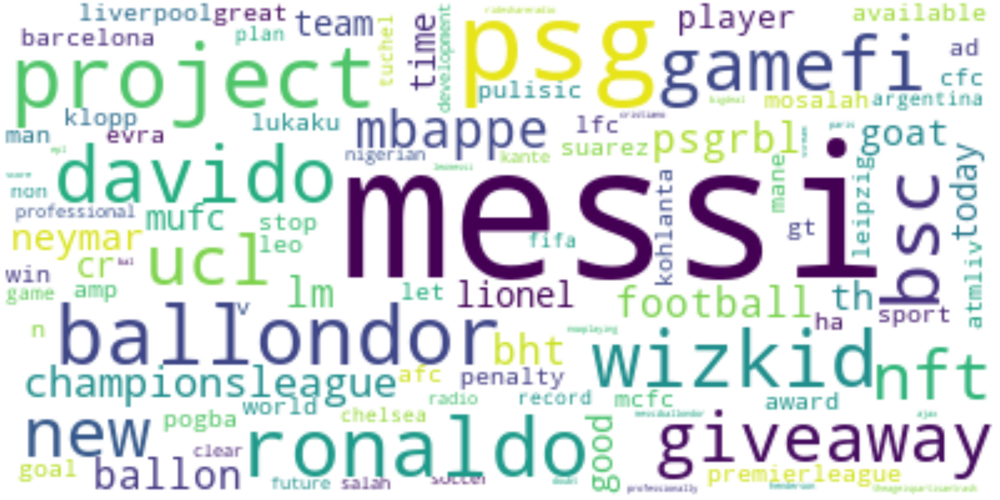

In [14]:
data = " ".join(map(str, total))
wordcloud = WordCloud(max_words=100, background_color="white", collocations = False).generate(data)

plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.rcParams['figure.figsize'] = [150, 150]
plt.show()

# Analisis de sentimiento

In [15]:
df = pd.read_csv("tweets_full - copia.csv", error_bad_lines=False)
df = df[['text']]
df = df.drop_duplicates()
URL_REGEX = r"(?i)\b((?:https?://|www\d{0,3}[.]|[a-z0-9.\-]+[.][a-z]{2,4}/)(?:[^\s()<>]+|\(([^\s()<>]+|(\([^\s()<>]+\)))*\))+(?:\(([^\s()<>]+|(\([^\s()<>]+\)))*\)|[^\s`!()\[\]{};:'\".,<>?«»“”‘’]))"
MENTIONS_REGEX = r"(?<=^|(?<=[^a-zA-Z0-9-_\.]))@([A-Za-z]+[A-Za-z0-9-_]+)"
HASHTAG_REGEX = r"#"

df["text"].replace(URL_REGEX,'',regex=True, inplace = True)
df["text"].replace(MENTIONS_REGEX,'',regex=True, inplace = True)
df["text"].replace(HASHTAG_REGEX,'',regex=True, inplace = True)
df["text"].replace(r"[^A-Za-z0-9 | \n]+",' ',regex=True, inplace = True)
df["text"].replace(r"\t",' ',regex=True, inplace = True)
df["text"].replace('[{}]'.format(string.punctuation),' ',regex=True, inplace = True)
df["text"].replace('[^a-zA-Z]',' ',regex=True, inplace = True)
df['text'].dropna(inplace=True)

df["text"] = df["text"].str.lower()

In [17]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
sentiment_analyzer = SentimentIntensityAnalyzer()

df["negative"] = ""
df["neutral"] = ""
df["positive"] = ""
df["result"] = ""
df["compound"] = ""

for index, row in df.iterrows():
    analisis = sentiment_analyzer.polarity_scores(row['text'])
    row["negative"] = analisis["neg"]
    row["neutral"] = analisis["neu"]
    row["positive"] = analisis["pos"]
    row["compound"] = analisis["compound"]
    
    if analisis['compound'] >= 0.5 and analisis['compound'] <= 1:
        row["result"] = "Positive"
    elif analisis['compound'] <= 0:
        row["result"] = "Negative"
    else :
        row["result"] = "Neutral"
        
df[df['result'] == "Negative"]

,text,negative,neutral,positive,result,compound
0,nnamdi kanu challenges competence of fg s fresh terrorism charges news nnamdikanubbnaija messi wizkid davido,0.315,0.516,0.169,Negative,-0.6249
1,our future ansufati ansufati fcbarcelona messi,0,1,0,Negative,0
3,ebonyi residents observe sit at home banks remove nigerian flags nnamdi kanu s trial news ebonyi nnamdikanu strialbbnaija messi wizkid davido,0,1,0,Negative,0
4,no credit for bruno ucl ronaldo mufc messi,0.238,0.762,0,Negative,-0.2924
6,the himself lm messi,0,1,0,Negative,0
14,the riveraly doesn t stop messi ronaldo,0.268,0.732,0,Negative,-0.296
19,police arrest two suspected armed robbers recover gun in delta nigerian news armedrobbers delta policebbnaija messi wizkid davido,0.309,0.691,0,Negative,-0.6908
21,lionel messi,0,1,0,Negative,0
22,police arrest three with tramadol weed others delta nigerian news delta policebbnaija messi wizkid davido,0.146,0.854,0,Negative,-0.34
25,you should have left juventus earlier chiellini hits out at ronaldo sport chiellini juventus ronaldobbnaija messi wizkid davido,0,1,0,Negative,0


¿Quíenes están involucrados?
Las personas que se involucran con Messi son: Cristiano Ronaldo, Mbappe y Neymar.

¿De qué se trata?
En los Twitts analizados, podemos concluir que el tema que mas se discute es sobre la UEFA Champions League, se menciona a Mbappe, su compañero de equipo en PSG. Ademas se lo suele comparar a Ronaldo como rival directo de Lionel Messi.
Por otra parte, una palabra muy nombrada es balon de oro. Ya que se aproxima la fecha para el nominado Balon de Oro y Messi es candidato a poder ganarlo.

¿En qué lugares ocurre la acción?
Principalmente la discusion se centra en Europa.

¿Qué opinion o sentimientos expresa la gente?
Dentro de los sentimientos que expresa la gente son variados, ya que segun los acontecimientos que van ocurriendo en el mundo del futbol, la gente va dando su opinion